In [5]:
import google.generativeai as genai
from PIL import Image
from IPython.display import display
import requests
from io import BytesIO
import json
import os
import time

In [ ]:
GEMINI_API_KEY = os.environ.get("GEMINI_API_KEY")
genai.configure(api_key=GEMINI_API_KEY)

In [ ]:
def extract_receipt_items(img_path):
    img = Image.open(img_path)
    model = genai.GenerativeModel('gemini-2.5-flash')
    
    prompt = """Extract all food/grocery items from this receipt.
    Return ONLY valid JSON array:
    [{"item": "item name", "quantity": "quantity (oz, lbs, etc.)"}]
    Please remove brand names from the item names.
    If the quantity is not given, make an estimate in the appropriate units.
    No explanation, just JSON."""
    
    response = model.generate_content([prompt, img])
    
    text = response.text.strip()
    if text.startswith('```json'):
        text = text.replace('```json', '').replace('```', '').strip()
    
    items = json.loads(text)
    return items

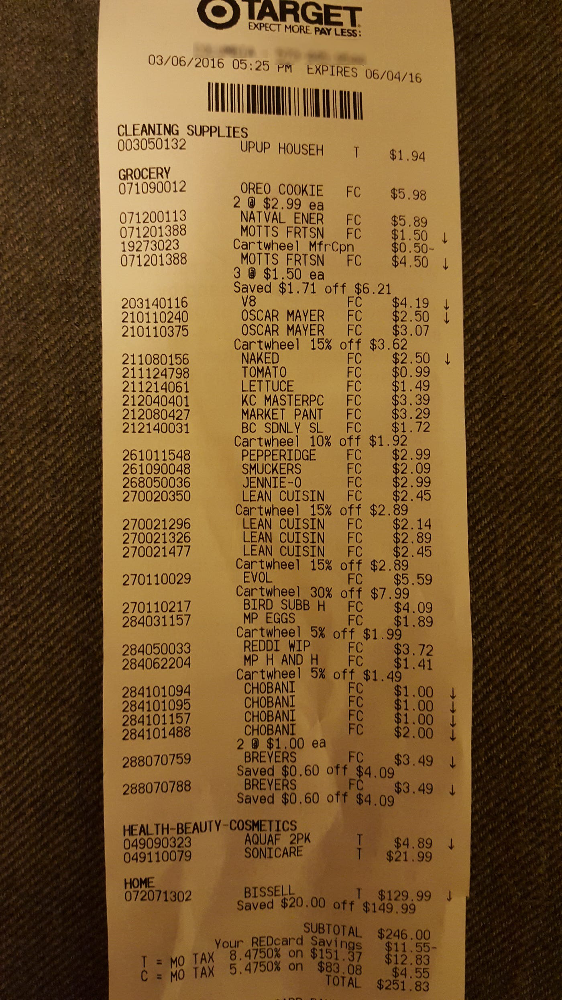

r3.jpg items:
- Cookies (28 oz)
- Energy drink (48 oz)
- Fruit snacks (27 oz)
- Vegetable juice (46 oz)
- Lunch meat (12 oz)
- Lunch meat (16 oz)
- Smoothie (15.2 oz)
- Tomato (0.5 lbs)
- Lettuce (1.25 lbs)
- Barbecue sauce (18 oz)
- Pantry item (16 oz)
- Snack mix (5 oz)
- Cookies (7 oz)
- Jam (12 oz)
- Turkey deli meat (12 oz)
- Frozen meal (8 oz)
- Frozen meal (8 oz)
- Frozen meal (8 oz)
- Frozen meal (8 oz)
- Frozen meal (10 oz)
- Frozen vegetables (20 oz)
- Eggs (1 dozen)
- Whipped topping (6.5 oz)
- Half and half (16 oz)
- Yogurt (5.3 oz)
- Yogurt (5.3 oz)
- Yogurt (5.3 oz)
- Yogurt (5.3 oz)
- Yogurt (10.6 oz)
- Ice cream (48 oz)
- Ice cream (48 oz)
----------------------------------------


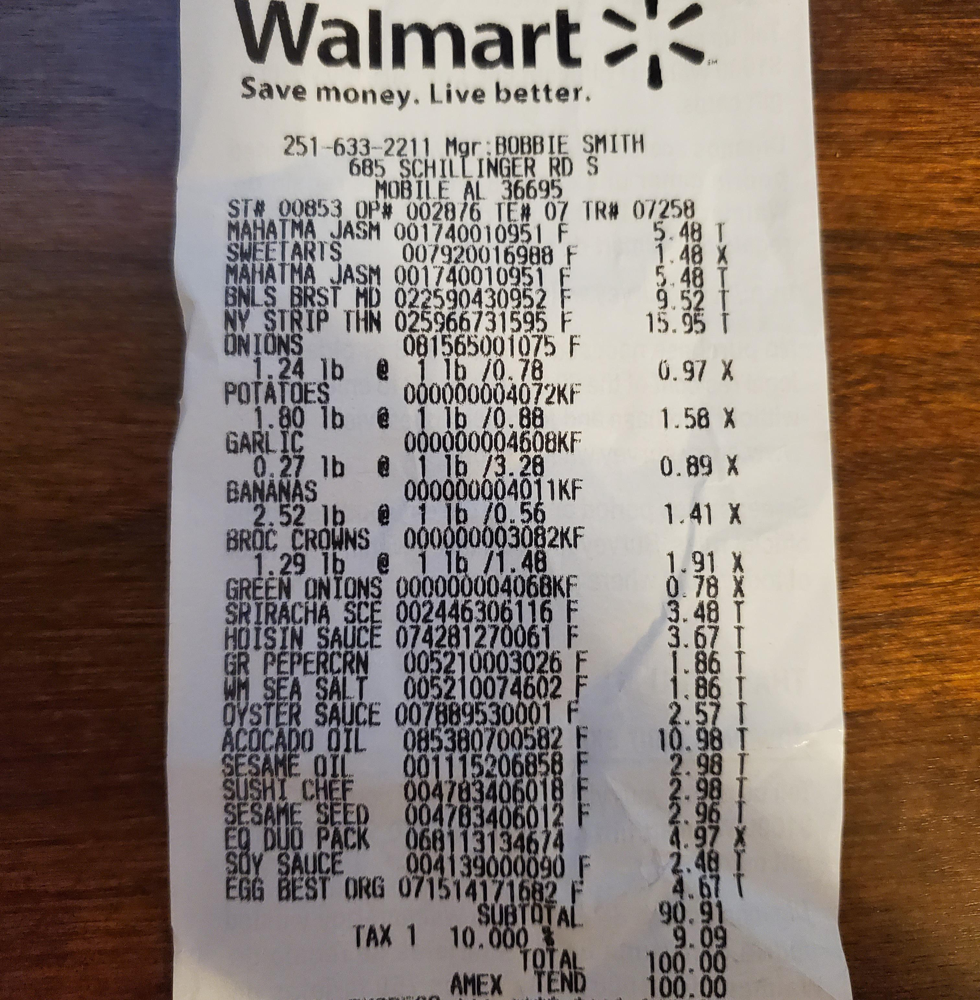

r1.jpg items:
- Sweet Tarts (5 oz)
- Jasmine Rice (2 lbs)
- Boneless Chicken Breast Medium (2 lbs)
- New York Strip Thin (0.8 lbs)
- Onions (1.24 lbs)
- Potatoes (1.80 lbs)
- Garlic (0.27 lbs)
- Bananas (2.52 lbs)
- Broccoli Crowns (1.29 lbs)
- Green Onions (1 bunch)
- Sriracha Sauce (17 oz)
- Hoisin Sauce (15 oz)
- Black Peppercorns (3 oz)
- Sea Salt (20 oz)
- Oyster Sauce (9 oz)
- Avocado Oil (16.9 oz)
- Sesame Oil (5 oz)
- Sushi Rice (1 lb)
- Sesame Seeds (4 oz)
- Eggs (24 count)
- Soy Sauce (10 oz)
- Organic Eggs (12 count)
----------------------------------------


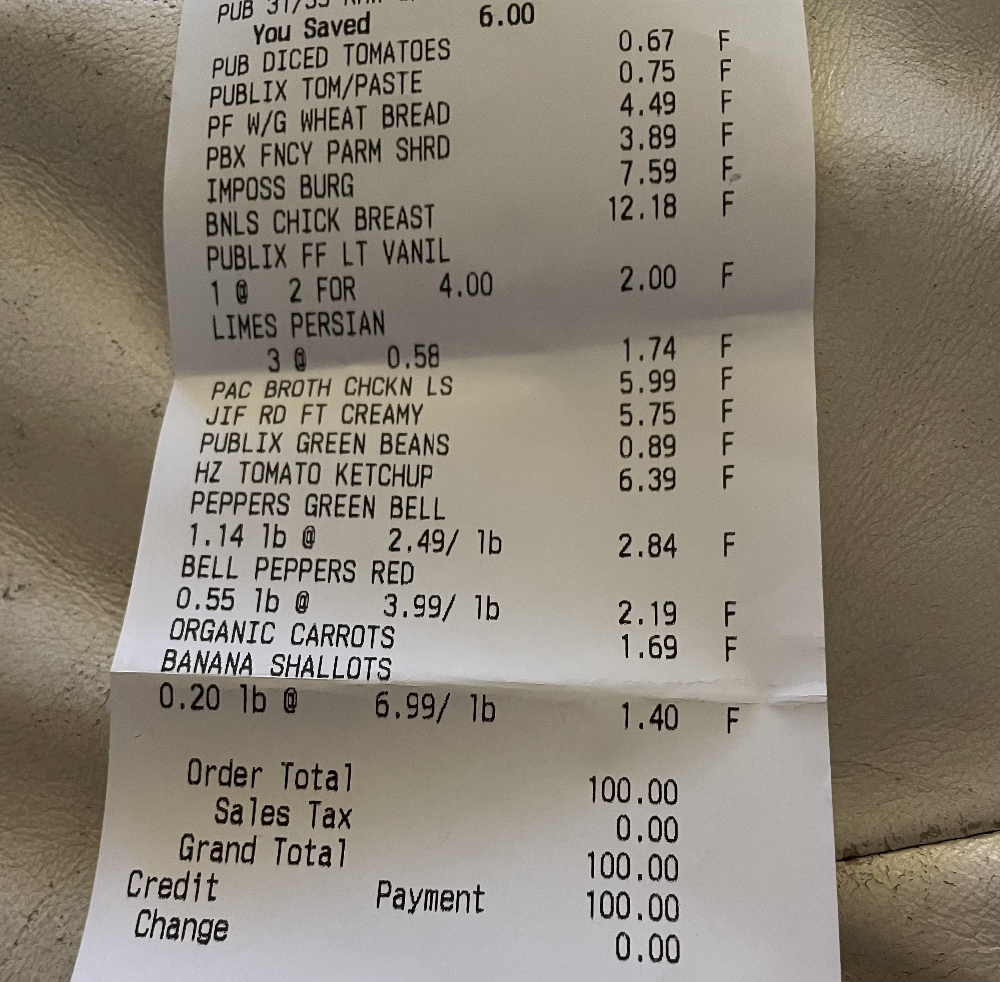

r0.jpg items:
- Diced Tomatoes (15 oz)
- Tomato Paste (6 oz)
- Whole Wheat Bread (1 loaf)
- Fancy Parmesan Shredded Cheese (6 oz)
- Plant-Based Burger (12 oz)
- Boneless Chicken Breast (2.5 lbs)
- Fat Free Light Vanilla Yogurt (32 oz)
- Persian Limes (3 units)
- Chicken Broth Low Sodium (32 oz)
- Creamy Peanut Butter (40 oz)
- Green Beans (15 oz)
- Tomato Ketchup (40 oz)
- Green Bell Peppers (1.14 lbs)
- Red Bell Peppers (0.55 lbs)
- Organic Carrots (1 lb)
- Banana Shallots (0.20 lbs)
----------------------------------------


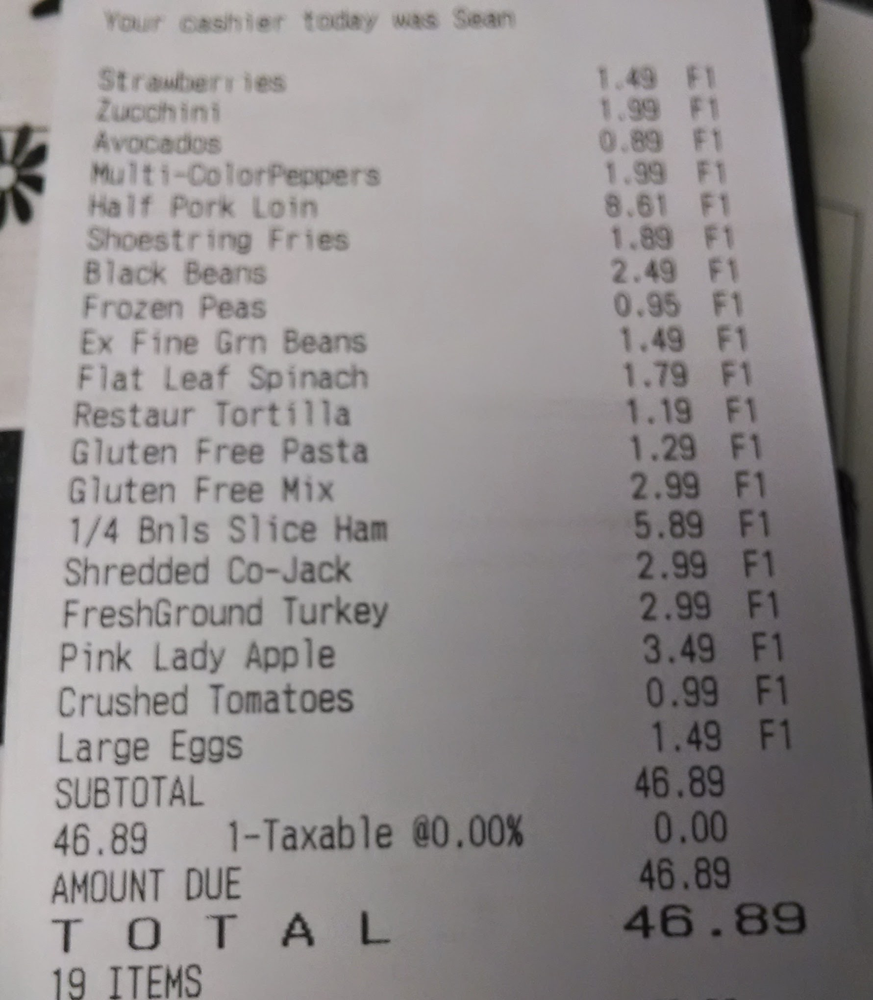

r7.jpg items:
- Strawberries (1 pint)
- Zucchini (1 lb)
- Avocados (1 unit)
- Multi-Color Peppers (1 bag)
- Pork Loin (2.5 lbs)
- Shoestring Fries (16 oz)
- Black Beans (15 oz)
- Frozen Peas (10 oz)
- Green Beans (10 oz)
- Spinach (6 oz)
- Tortilla (10 units)
- Pasta (12 oz)
- Gluten Free Mix (16 oz)
- Sliced Ham (2.5 lbs)
- Shredded Cheese (8 oz)
- Ground Turkey (16 oz)
- Apple (2 lbs)
- Crushed Tomatoes (14.5 oz)
- Eggs (1 dozen)
----------------------------------------


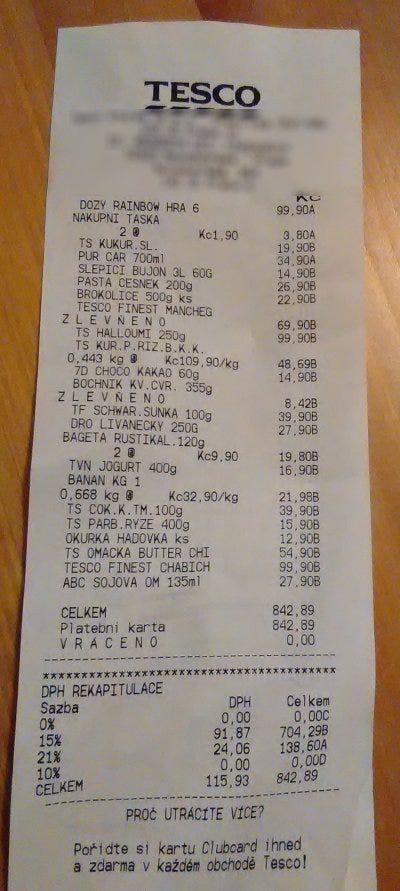

r6.jpg items:
- Sweet Corn (350g)
- Chicken Bouillon (60g)
- Garlic Paste (200g)
- Broccoli (500g)
- Manchego Cheese (200g)
- Halloumi Cheese (250g)
- Chicken Pieces (0.443 kg)
- Cocoa Powder (60g)
- Bread Loaf (355g)
- Black Forest Ham (100g)
- Small Pancakes (250g)
- Rustic Baguette (120g)
- Yogurt (400g)
- Banana (0.668 kg)
- Dark Chocolate Pieces (100g)
- Parboiled Rice (400g)
- Cucumber (350g)
- Butter Chicken Sauce (400g)
- Chabichou Cheese (130g)
- Soy Sauce (135ml)
----------------------------------------


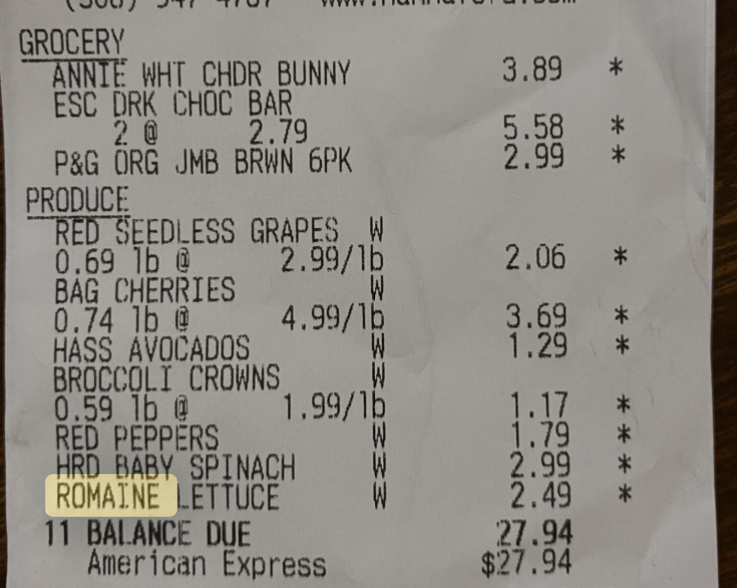

r8.png items:
- White Cheddar Bunny Snacks (6 oz)
- Dark Chocolate Bar (6 oz)
- Organic Jumbo Brownie (24 oz)
- Red Seedless Grapes (0.69 lbs)
- Bag Cherries (0.74 lbs)
- Hass Avocados (6 oz)
- Broccoli Crowns (0.59 lbs)
- Red Peppers (8 oz)
- Baby Spinach (5 oz)
- Romaine Lettuce (12 oz)
----------------------------------------


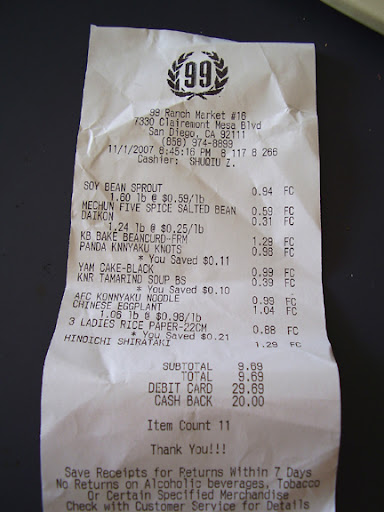

r9.jpg items:
- Soy Bean Sprout (1.60 lbs)
- Five Spice Salted Bean (1 unit)
- Daikon (1.24 lbs)
- Baked Beancurd (1 package)
- Konnyaku Knots (1 package)
- Black Yam Cake (1 unit)
- Tamarind Soup Base (1 package)
- Konnyaku Noodle (1 package)
- Chinese Eggplant (1.06 lbs)
- Rice Paper (1 package)
- Shirataki (1 package)
----------------------------------------


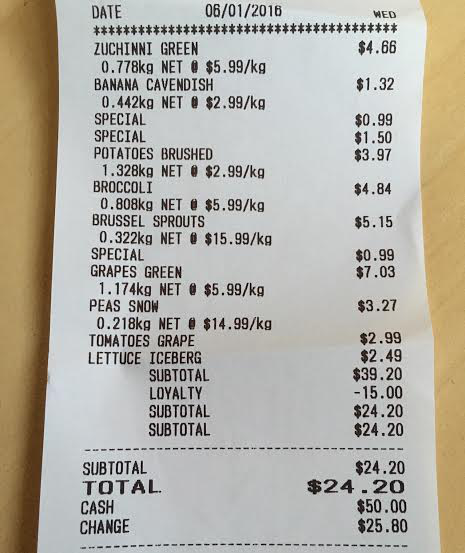

r2.jpeg items:
- Zucchini (0.778 kg)
- Banana (0.442 kg)
- Potatoes (1.328 kg)
- Broccoli (0.808 kg)
- Brussel Sprouts (0.322 kg)
- Grapes (1.174 kg)
- Peas (0.218 kg)
- Tomatoes (0.4 kg)
- Lettuce (0.7 kg)
----------------------------------------


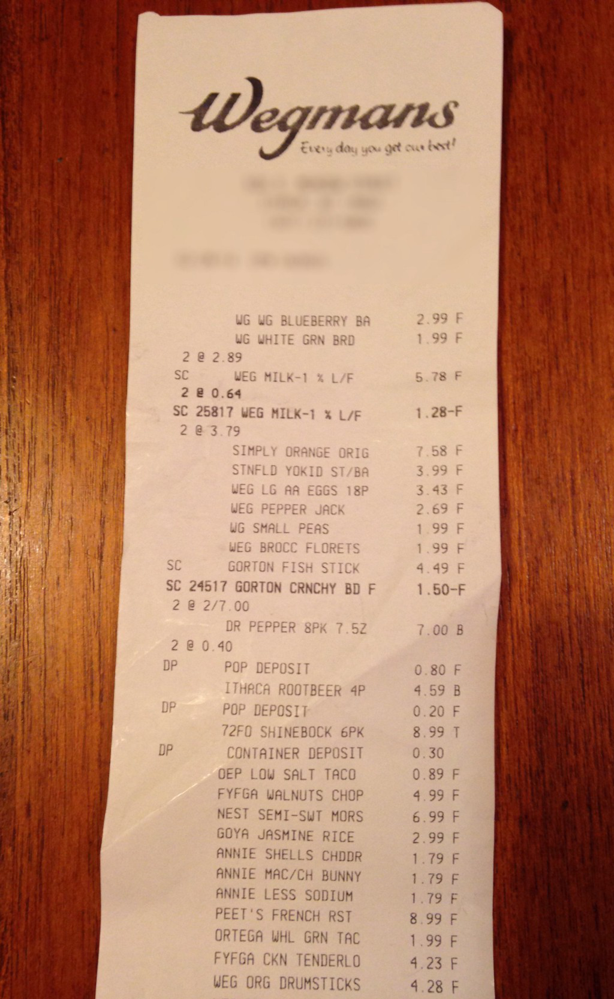

r5.jpeg items:
- Blueberry Bagels (6 count)
- White Bread (1 loaf)
- Milk 1% Low Fat (2 half-gallons)
- Milk 1% Low Fat (2 pints)
- Orange Juice Original (89 fl oz)
- Kids Yogurt (6-pack)
- Large AA Eggs (18 count)
- Pepper Jack Cheese (8 oz)
- Small Peas (16 oz)
- Broccoli Florets (16 oz)
- Fish Sticks (12 oz)
- Crunchy Breaded Fish (6 oz)
- Soda (8 x 7.5 fl oz)
- Rootbeer (4 x 12 fl oz)
- Shinebock Beer (6 x 12 fl oz)
- Taco Seasoning (1 oz)
- Chopped Walnuts (8 oz)
- Semi-Sweet Chocolate Morsels (24 oz)
- Jasmine Rice (2 lbs)
- Shells & Cheddar Mac & Cheese (6 oz)
- Mac & Cheese Bunny Shaped (6 oz)
- Less Sodium Mac & Cheese (6 oz)
- French Roast Coffee (12 oz)
- Whole Grain Taco Shells (10 count)
- Chicken Tenderloins (1 lb)
- Organic Drumsticks (1 lb)
----------------------------------------


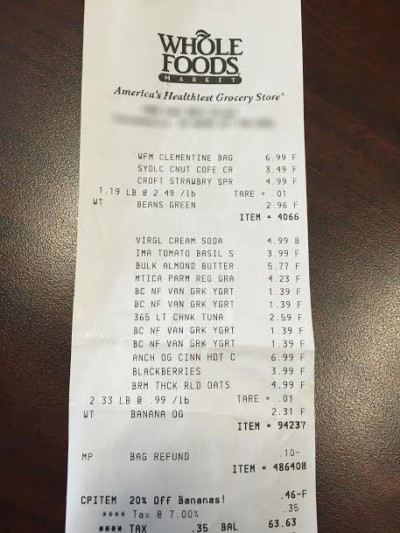

r4.jpeg items:
- Clementine (2 lbs)
- Coconut Coffee Creamer (16 fl oz)
- Strawberry Spread (12 oz)
- Green Beans (1.19 lbs)
- Cream Soda (25 fl oz)
- Tomato Basil Sauce (24 oz)
- Almond Butter (0.6 lbs)
- Parmesan Grated Cheese (8 oz)
- Vanilla Greek Yogurt (5.3 oz)
- Vanilla Greek Yogurt (5.3 oz)
- Vanilla Greek Yogurt (5.3 oz)
- Light Chunk Tuna (5 oz)
- Vanilla Greek Yogurt (5.3 oz)
- Cinnamon Hot Cereal (16 oz)
- Blackberries (6 oz)
- Thick Rolled Oats (24 oz)
- Banana (2.33 lbs)
----------------------------------------


In [ ]:
folder_path = "test_receipts"
all_receipts_items = {}

for filename in os.listdir(folder_path):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(folder_path, filename)
        try:
            img = Image.open(img_path)
            display(img)

            items = extract_receipt_items(img_path)
            all_receipts_items[filename] = items

            print(f"{filename} items:")
            for item in items:
                print(f"- {item['item']} ({item['quantity']})")
            print("-" * 40)

            # Prevent rate limiting
            time.sleep(2)
            
        except Exception as e:
            print(f"Error processing {filename}: {e}")